In [11]:
import numpy as np 
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn import preprocessing

import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

import seaborn as sns
import plotly.express as px

from sklearn import metrics
import math

sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})



In [8]:
import umap

In [42]:
train = pd.read_csv("C:/Users/eduardo.tadeo/Documents/Master Thesis/Python/pm_nasa_cmapss/Datasets/CMAPSSData/train_FD002.txt", delimiter = ' ')


In [43]:
for i in range(train['Unit'].max()):

    train_Unit = train[train['Unit']==(i+1)]

    UL = train_Unit['Cycle'].max() # UsefulLife

    train.loc[train['Unit']==i+1, 'UL'] = UL
    train.loc[train['Unit']==i+1, 'RUL'] = UL - train.loc[train['Unit']==i+1, 'Cycle'] 
    train.loc[train['Unit']==i+1, 'RUL_index'] = train.loc[train['Unit']==i+1, 'RUL'] / train.loc[train['Unit']==i+1, 'UL']




In [44]:
data_umap = train.iloc[:,2:-7]

trans = umap.UMAP().fit(data_umap)
train_emb = trans.embedding_



Text(0, 0.5, 'Remaining Useful Life Index')

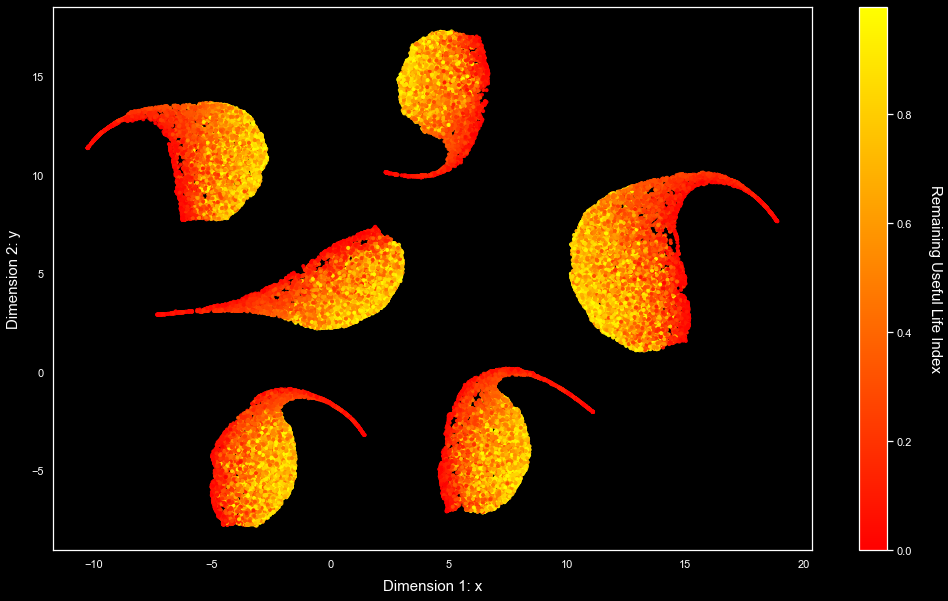

In [49]:
plt.style.use('dark_background')

fig = plt.figure(figsize = (17,10) )

ax = fig.add_subplot(111)
plot = ax.scatter(train_emb[:,0], train_emb[:,1], c = train['RUL_index'], cmap= 'autumn', marker = '.', label = 'Useful Lifetime')

ax.set_xlabel("Dimension 1: x", size = 15, labelpad = 10)
ax.set_ylabel("Dimension 2: y", size = 15, labelpad = 10)
ax.tick_params(colors = 'white')


cbar = plt.colorbar(plot)

cbar.ax.set_ylabel('Remaining Useful Life Index', rotation = 270, size = 15, labelpad = +30)

Text(0, 0.5, 'Remaining Useful Life Index')

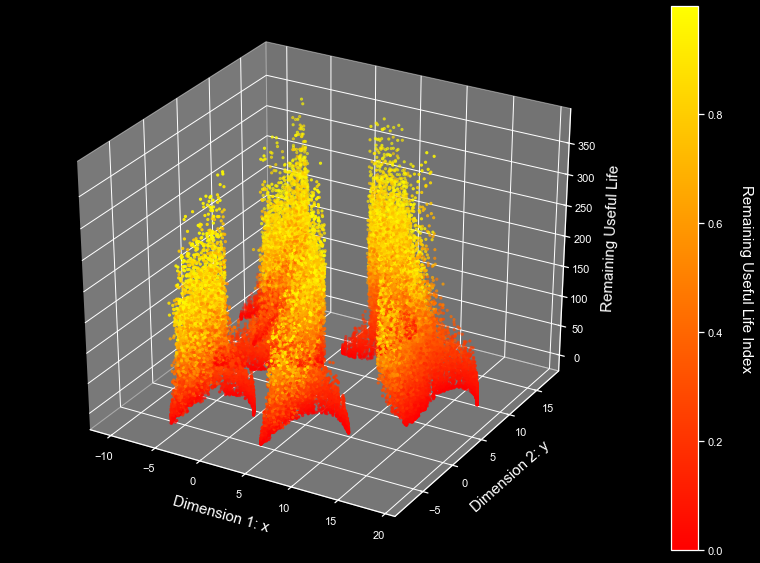

In [47]:
fig = plt.figure()

ax = fig.add_subplot(111, projection = '3d')

plot = ax.scatter(train_emb[:,0], train_emb[:,1], train['RUL'], c = train['RUL_index'], cmap = 'autumn', marker = '.')

ax.set_xlabel("Dimension 1: x", size = 15, labelpad = 10)
ax.set_ylabel("Dimension 2: y", size = 15, labelpad = 10)
ax.set_zlabel("Remaining Useful Life", size = 15, labelpad = 10)


ax.tick_params(colors = 'white')

cbar = plt.colorbar(plot)

cbar.ax.set_ylabel('Remaining Useful Life Index', rotation = 270, size = 15, labelpad = +30)


In [25]:
import plotly.express as px

df = pd.DataFrame(train_emb, columns = ['Primera', 'Segunda'])
df['RUL'] = train['RUL']

fig = px.scatter_3d(df, x = 'Primera', y = 'Segunda', z = 'RUL')

fig.show()